In [1]:
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt
import os.path as path
import os
import matplotlib.image as mpimg

%matplotlib inline


def calibrate_camera(calib_images_dir, verbose=False, saveimg=False):
    """
    This function is to Calibrate the camera images in a given directory containing calibration chessboards.
    1. param calib_images_dir: directory containing chessboard frames
    2. param verbose: default is False. if True, draw and show chessboard corners
    3. param saveimg: default is False. if True, save the image
    4. returns -> calibration parameters
    """
    
    # make sure the directory path exists
    # assert os.path.exists(calib_images_dir), '"{}" must exist and contain calibration images.'.format(calib_images_dir)

    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6 * 9, 3), np.float32)
    objp[:, :2] = np.mgrid[0:9, 0:6].T.reshape(-1, 2)

    # Arrays to store object points and image points from all the images.
    objpoints = []  # 3d points in real world space
    imgpoints = []  # 2d points in image plane.

    # Make a list of calibration images
    #images = glob.glob(path.join(calib_images_dir, 'calibration*.jpg'))
    images = glob.glob(calib_images_dir)

    # Step through the list and search for chessboard corners
    for fname in images:

        img = cv2.imread(fname)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)

        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            if verbose:
                # Draw and display the corners
                img = cv2.drawChessboardCorners(img, (9, 6), corners, ret)
                filename = fname.split('/')[1]
                f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
                #ax1.imshow(cv2.cvtColor(mpimg.imread(fname), cv2.COLOR_BGR2RGB))
                ax1.imshow(cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB))
                ax1.set_title(filename + '  Original Image', fontsize=18)
                ax2.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                ax2.set_title(filename + '  With Corners', fontsize=18)
                
            if saveimg:
                save_directory = "output_images/"
                #if not os.path.isdir(save_directory):
                #    os.mkdir("C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/")
                filename = fname.split('/')[1]
                original_filepath = save_directory + filename[:-4] + "_original.jpg"
                #cv2.imwrite(original_filepath,mpimg.imread(fname))
                cv2.imwrite(original_filepath,cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB))
                calibrated_filepath = save_directory + filename[:-4] + "_with_Corners.jpg"
                cv2.imwrite(calibrated_filepath,cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

    return ret, mtx, dist, rvecs, tvecs

def undistort(img, mtx, dist, verbose=False, saveimg= False):
    """
    This function is to Undistort a image, given camera matrix and distortion coefficients.
    1. param img: input image
    2. param mtx: camera matrix
    3. param dist: distortion coefficients
    4. param verbose: default is false. if True, show frame before/after distortion correction
    5. parm saveimg:  default is false. if True, show frame before/after distortion correction
    6. return - > undistorted image
    """
    img_undistorted = cv2.undistort(img, mtx, dist,None, mtx)

    if verbose:      
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
        ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax1.set_title(fname.split('/')[1] + '  Original Image', fontsize=18)
        ax2.imshow(cv2.cvtColor(img_undistorted, cv2.COLOR_BGR2RGB))
        ax2.set_title(fname.split('/')[1] + '  undistorted image', fontsize=18)
        
    if saveimg:     
        save_directory = "output_images/"
        #if not os.path.isdir(save_directory):
        #    os.mkdir("C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/")
        filename = fname.split('/')[1]
        undistort_filepath = save_directory + filename[:-4] + "_Undistorted.jpg"
        #cv2.imwrite(undistort_filepath,cv2.cvtColor(img_undistorted, cv2.COLOR_BGR2RGB))   
        cv2.imwrite(undistort_filepath, img_undistorted)        
        
    return img_undistorted

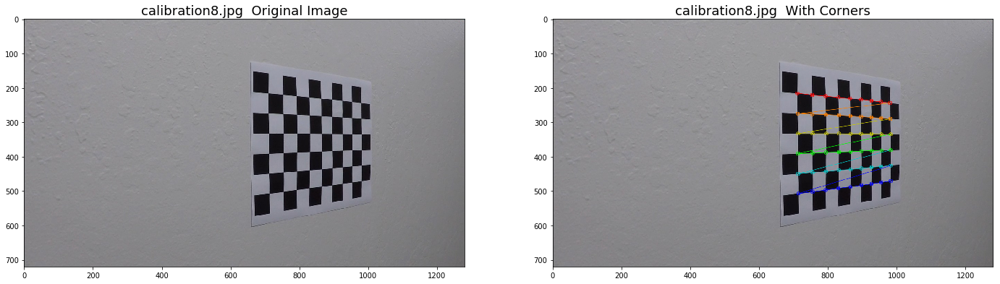

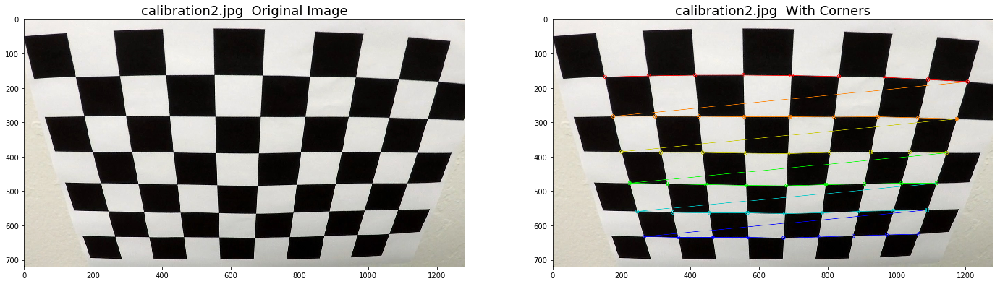

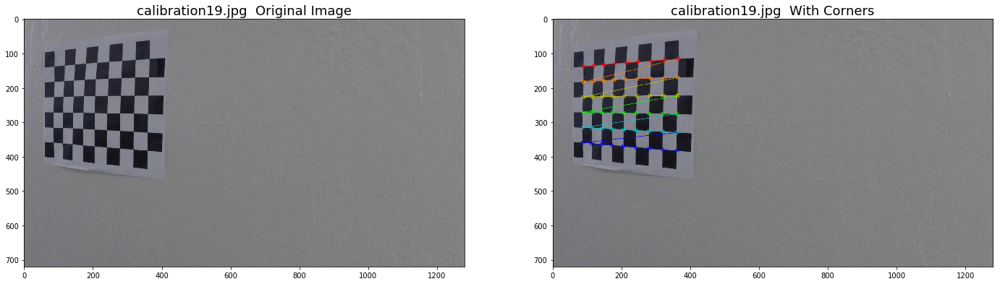

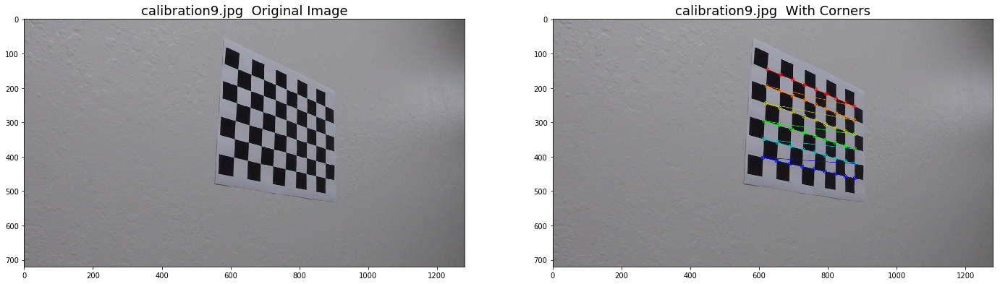

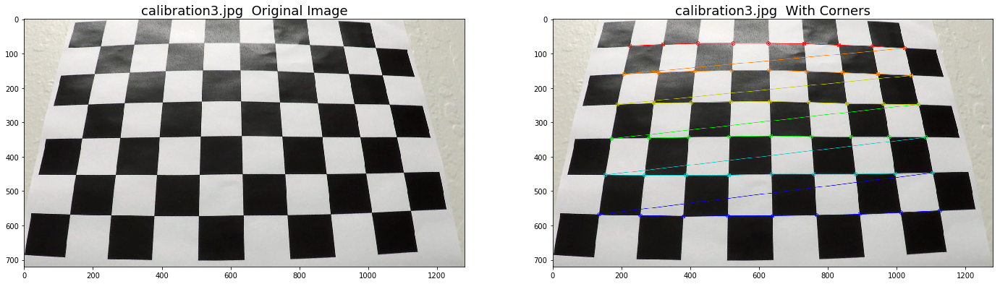

...

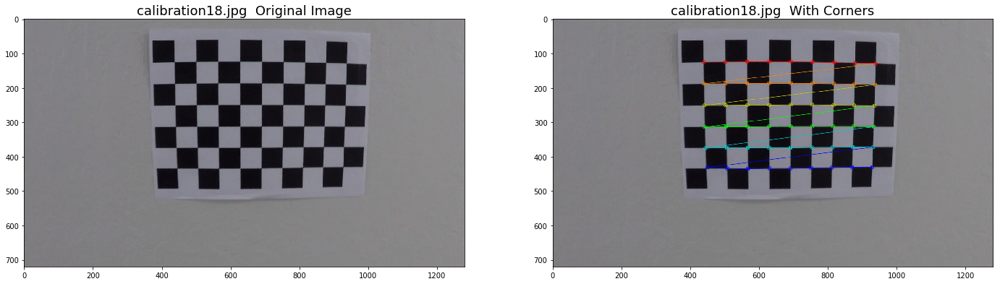

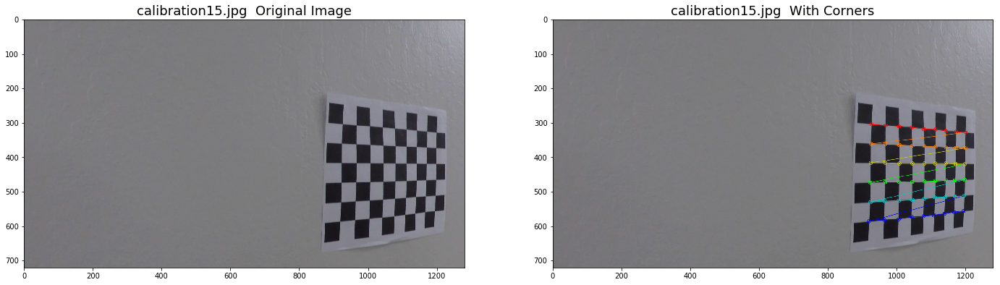

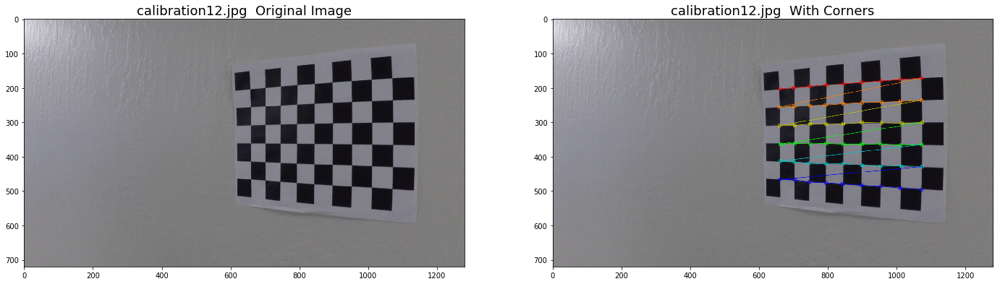

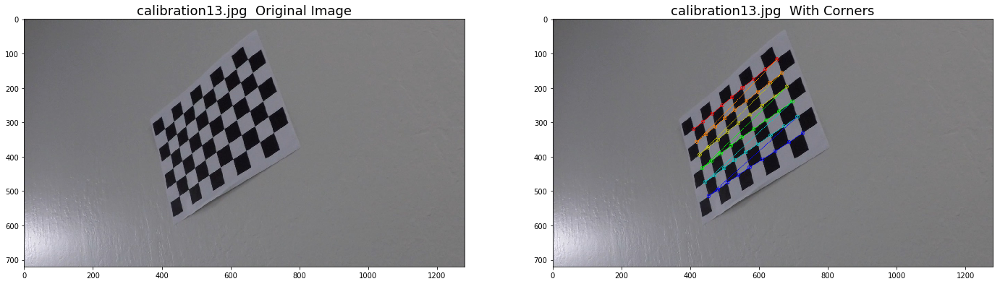

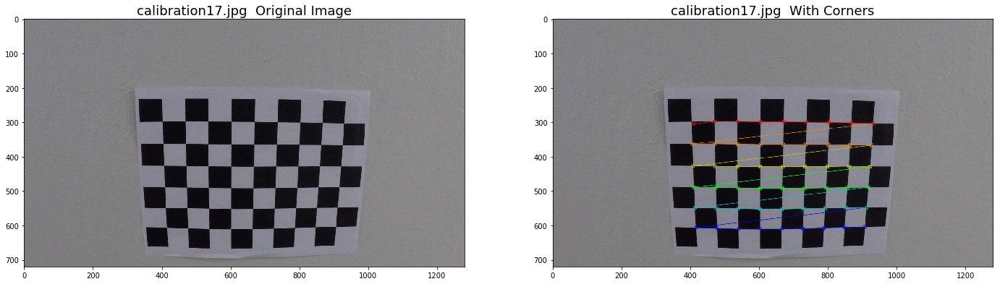

In [2]:
#1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images

#calib_images_dir='C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/camera_cal'
calib_images_dir='camera_cal/calibration*.jpg'

ret, mtx, dist, rvecs, tvecs = calibrate_camera(calib_images_dir,True,True)

In [3]:
# print(retval)
print("Camera calibration matrix is:")
print(mtx)
print("Distortion coefficients are:")
print(dist)

Camera calibration matrix is:
[[  1.15777818e+03   0.00000000e+00   6.67113857e+02]
 [  0.00000000e+00   1.15282217e+03   3.86124583e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
Distortion coefficients are:
[[-0.24688507 -0.02373155 -0.00109831  0.00035107 -0.00259867]]


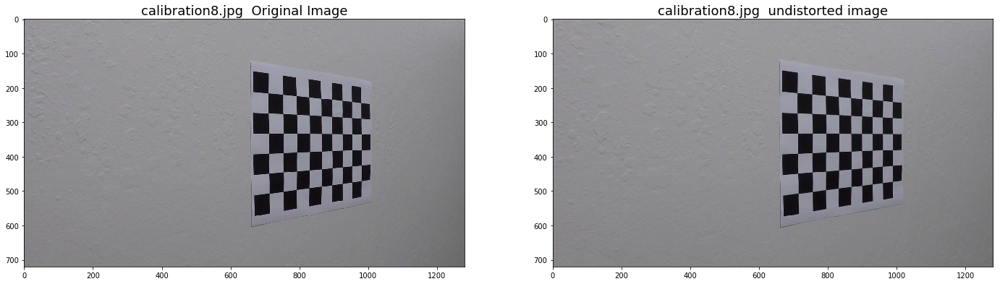

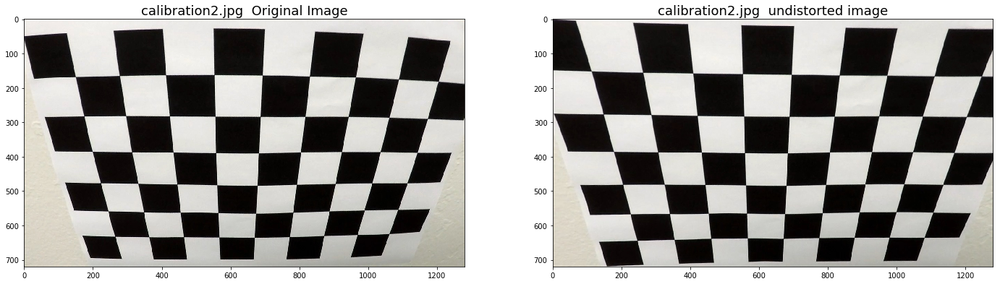

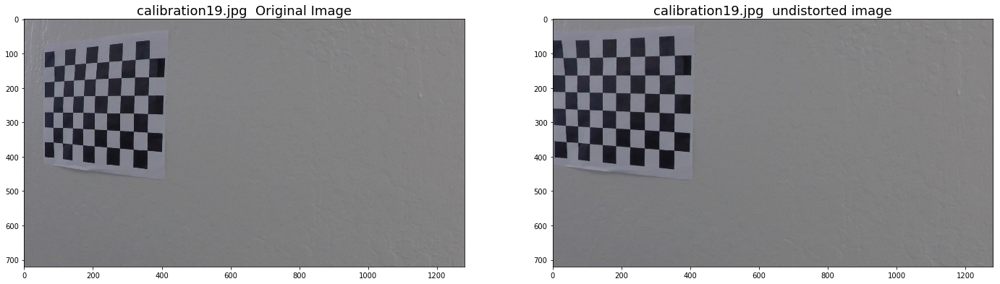

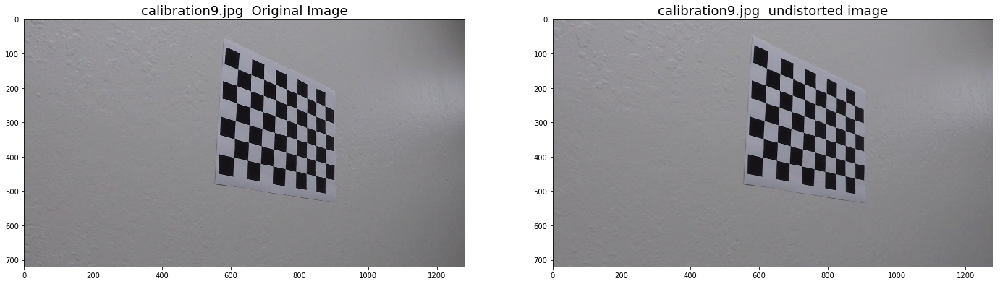

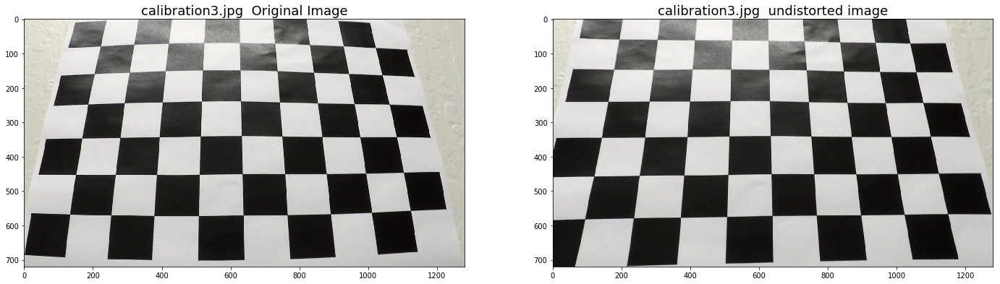

...

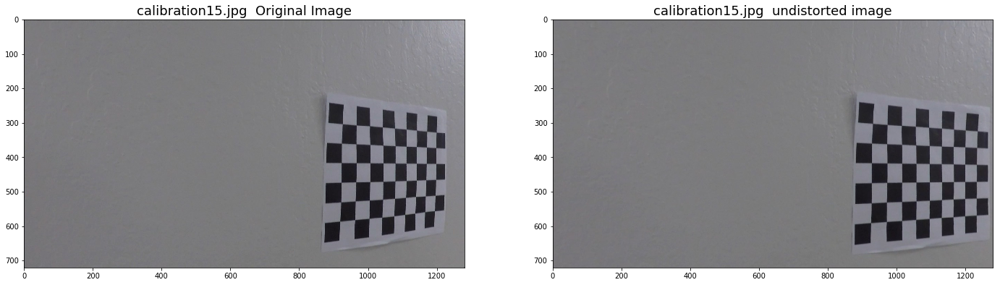

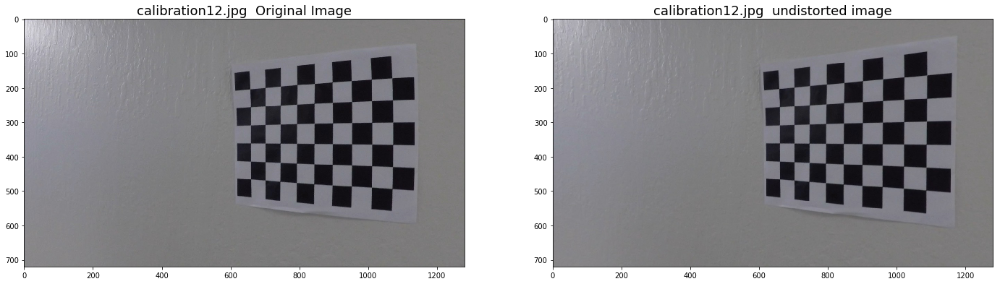

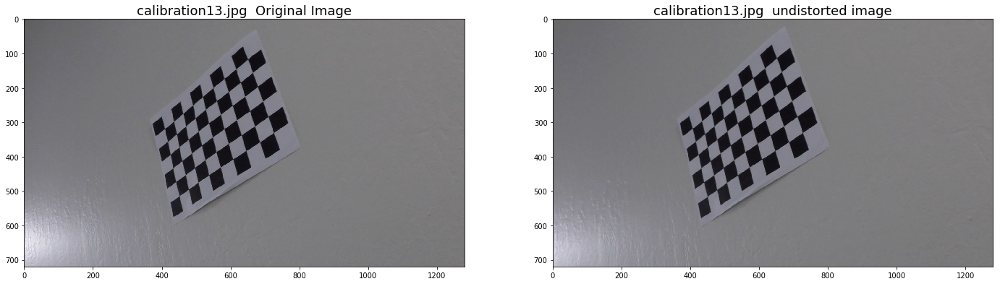

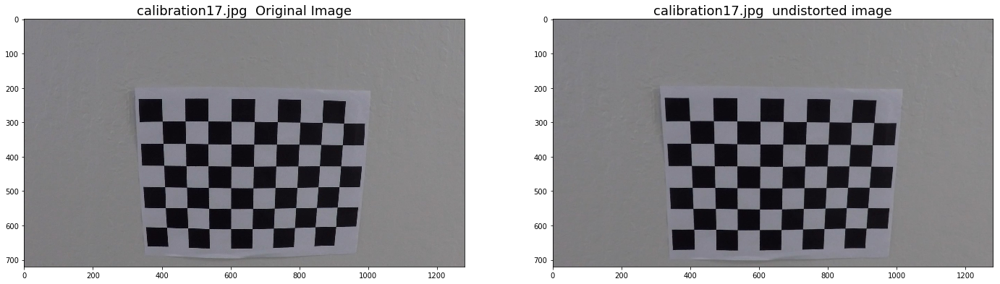

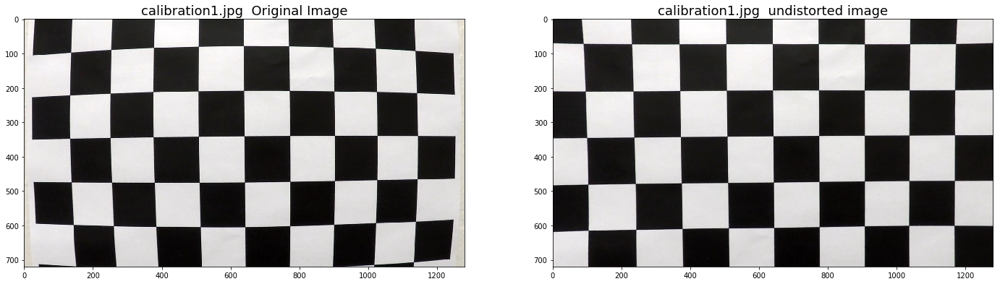

In [4]:
images = glob.glob('camera_cal/calibration*.jpg')

for fname in images:
        img = cv2.imread(fname)
      #  gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        undist = undistort(img, mtx, dist,True,True)

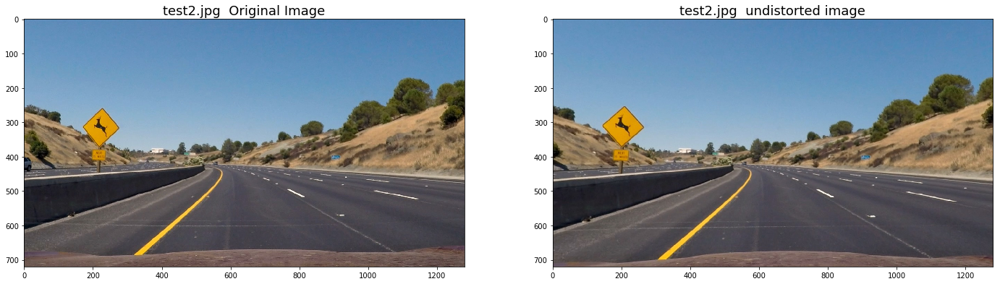

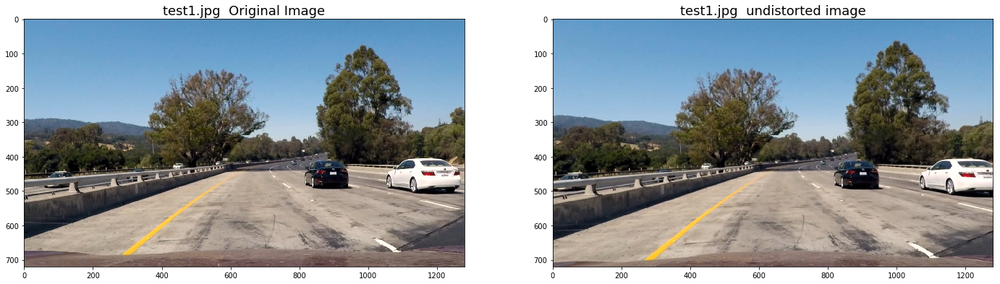

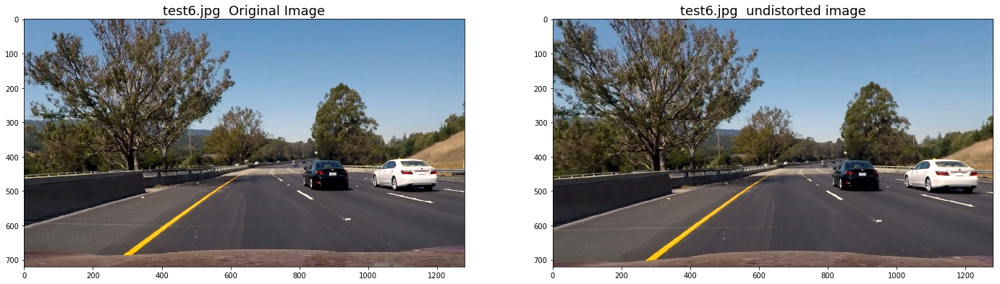

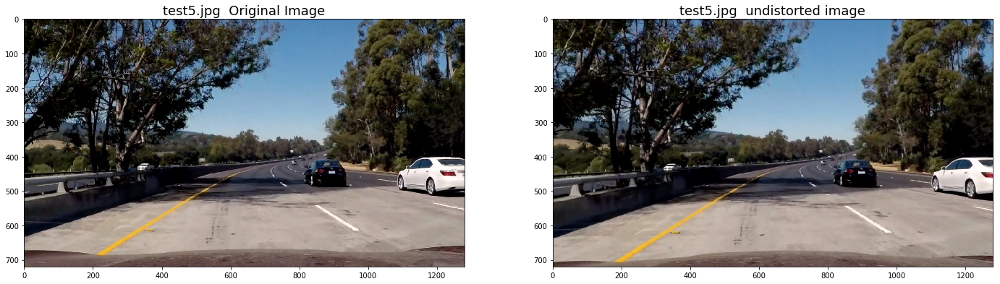

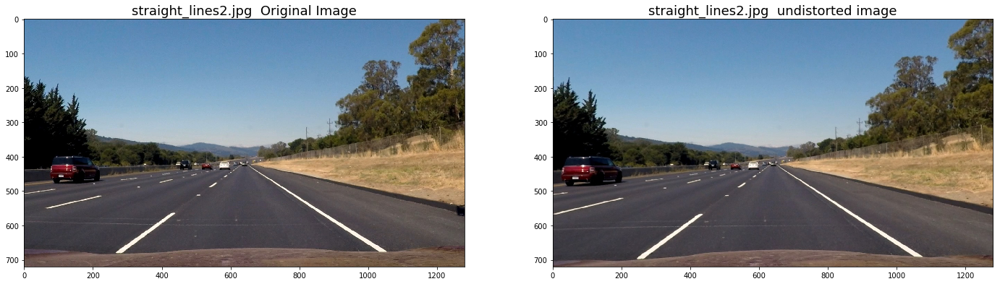

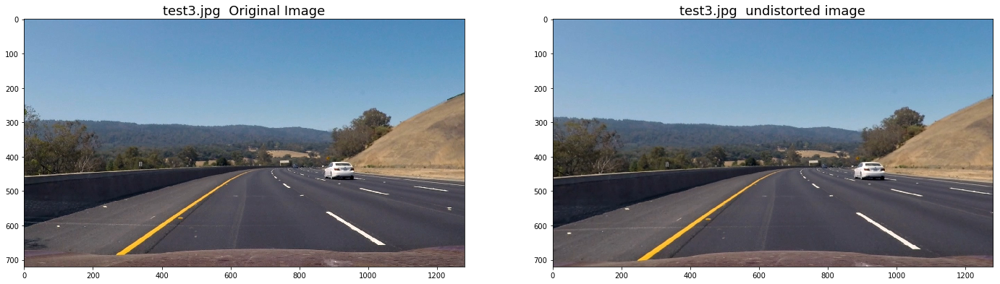

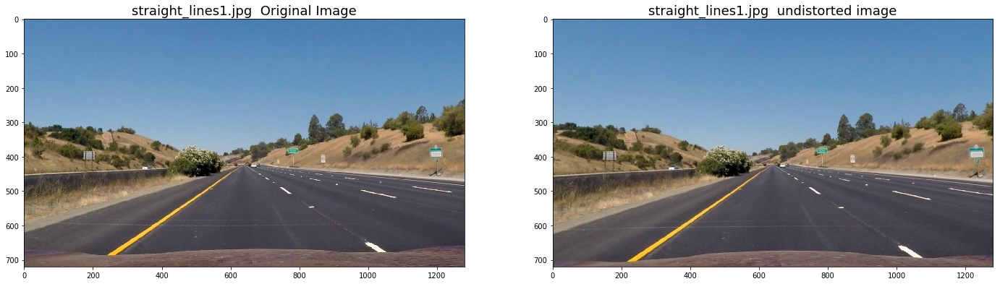

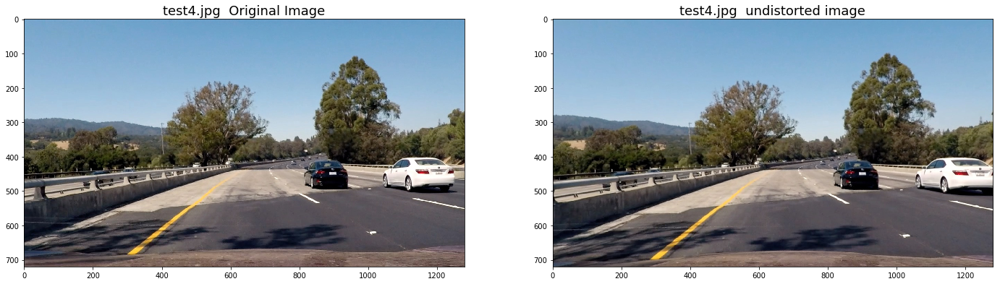

In [5]:
# 2. Apply a distortion correction to raw images using calibration matrix and distortion coefficients

test_images = glob.glob('test_images/*.jpg')

for fname in test_images:
        img = cv2.imread(fname)
      #  gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        undist = undistort(img, mtx, dist,True,True)

In [6]:
# 3. Use color transforms, gradients, etc., to create a thresholded binary image
def Thresh_Binary_Image(img, s_thresh=(170, 255), sx_thresh=(20, 100), verbose=False):
    """
    This function is to Undistort a image, given camera matrix and distortion coefficients.
    1. param img: input image
    2. param s_thresh: s channel threshold
    3. param sx_thres:  sobel x threshold
    4. param verbose: default is false. if True, show image before/after distortion correction
    5. return - > combined threshold binary image, color binary image
    """
    print
    img = np.copy(img)
    
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Stack each channel
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
   
    #combined binary
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    
    if verbose:  
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 15))
        f.tight_layout()

        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=40)

        ax2.imshow(color_binary, cmap='gray')
        ax2.set_title('Color Binary image', fontsize=40)
    
        ax3.imshow(combined_binary, cmap='gray')
        ax3.set_title('Thresholded combined Binary image', fontsize=40)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        
    return combined_binary, color_binary

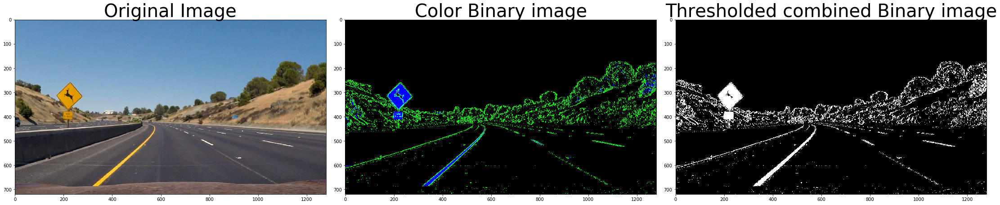

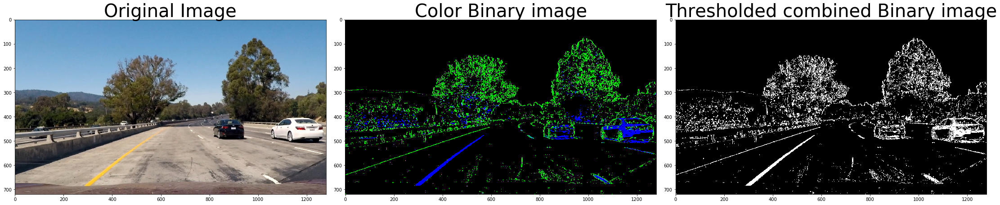

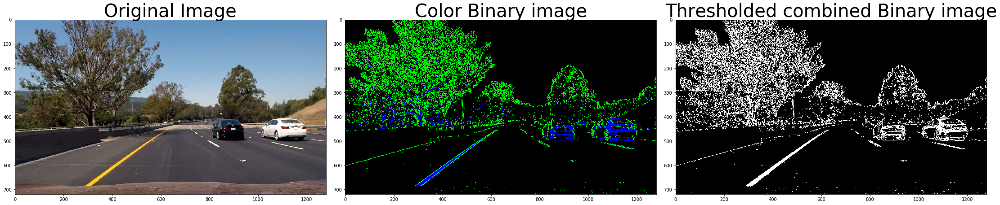

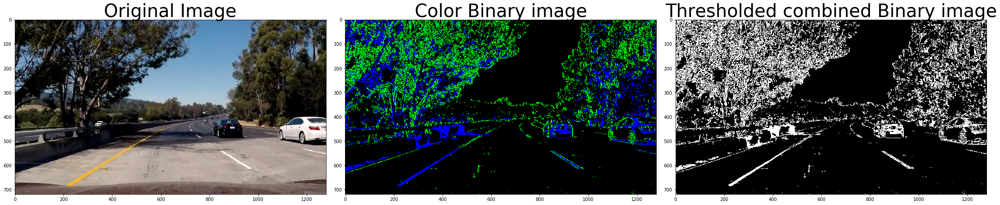

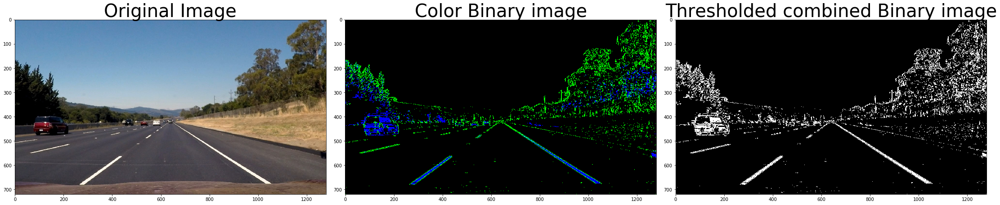

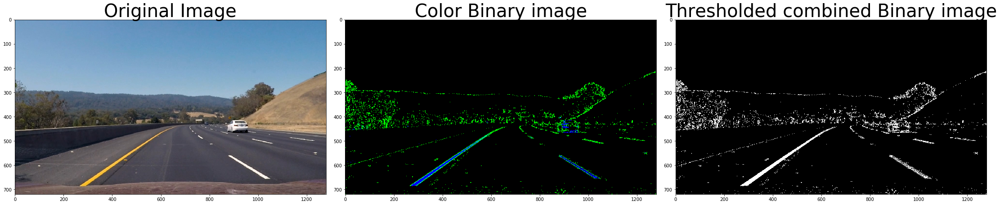

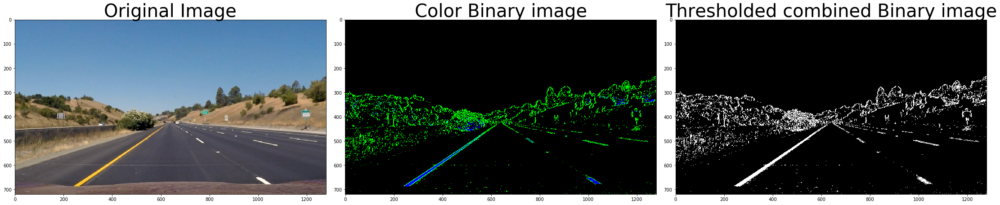

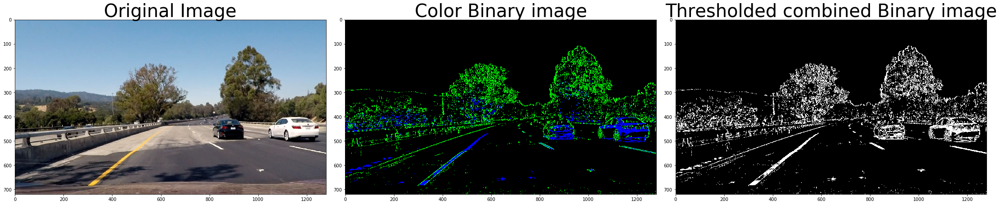

In [7]:
test_images = glob.glob('test_images/*.jpg')

for fname in test_images:
        img = mpimg.imread(fname)
        combined_binary, color_binary = Thresh_Binary_Image(img, s_thresh=(170, 255), sx_thresh=(20, 100), verbose=True)
    
        save_directory = "output_images/"
    #    #if not os.path.isdir(save_directory):
    #    #    os.mkdir("C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/")
        filename = fname.split('/')[1]
        Colorbinary_filepath = save_directory + filename[:-4] + "_Color_binary.jpg"      
        plt.imsave(Colorbinary_filepath, color_binary, cmap='gray')
        Combinedbinary_filepath = save_directory + filename[:-4] + "_Combined_binary.jpg"   
        plt.imsave(Combinedbinary_filepath,combined_binary, cmap='gray') 


In [8]:
# 4. Apply a perspective transform to rectify binary image ("birds-eye view")

#def Warped_image(img, src, dst):
def Warped_image(img):
    """
    This function is to perform perspective transform on image.
    1. param img: input image
    2. returns - > Warped image, M amd M inverse
    
    """
    #h, w = img.shape[:2]

    #src = np.float32([[585, h-10],    # br
    #                  [0, h-10],    # bl
    #                  [546, 460],   # tl
    #                  [732, 460]])  # tr
    #dst = np.float32([[w, h],       # br
    #                  [0, h],       # bl
    #                  [0, 0],       # tl
    #                  [w, 0]])      # tr

    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
        
    M = cv2.getPerspectiveTransform(src, dst)
    M_inv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)  
    
    return warped, M, M_inv



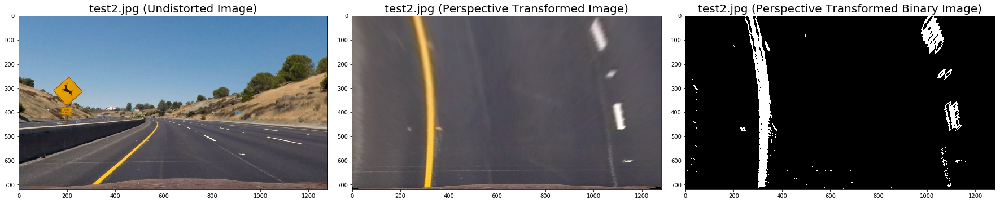

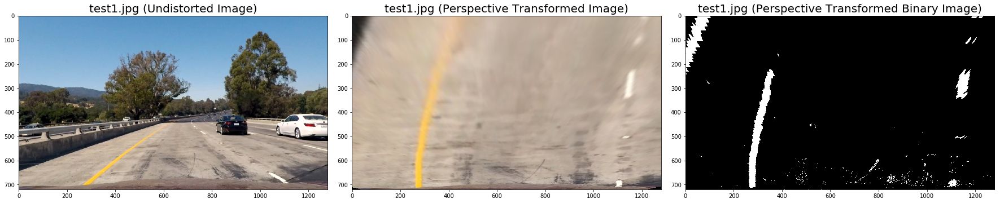

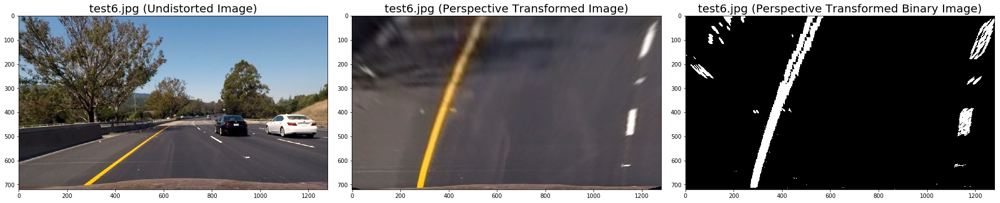

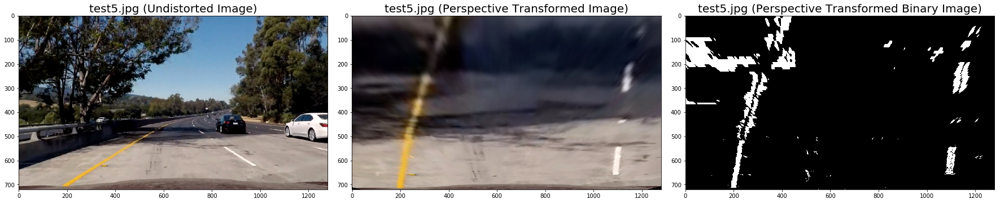

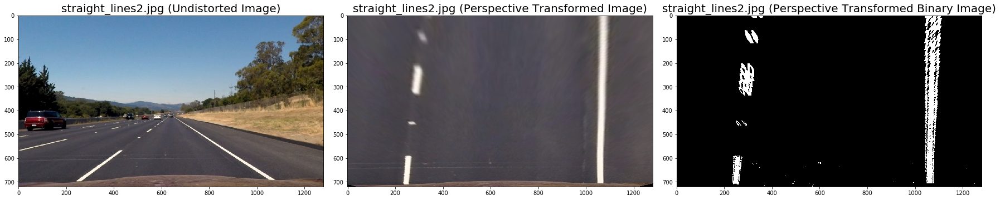

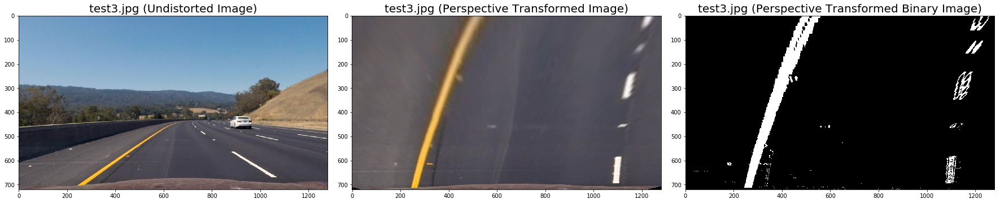

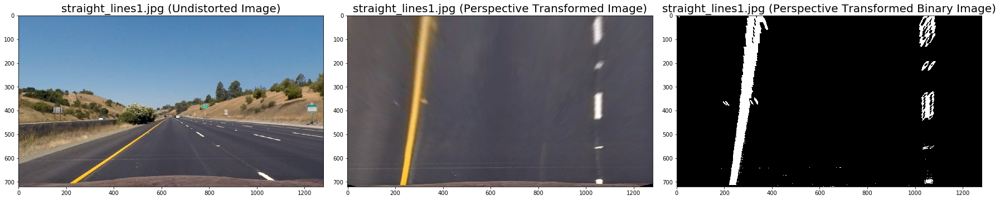

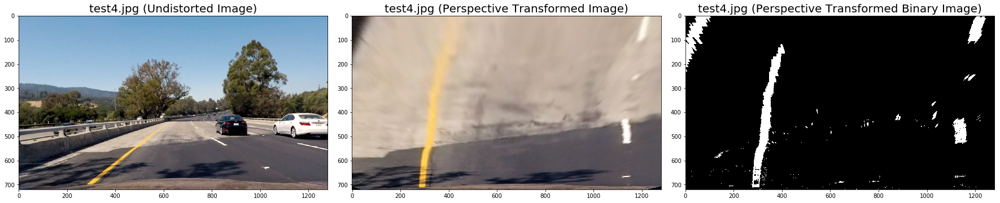

In [9]:
test_images = glob.glob('test_images/*.jpg')

src = np.float32([[170,720],[560,460],[706,460],[1130,720]])
dst = np.float32([[200,720],[200,0],[1080,0],[1080,720]])

#src = np.float32([[585,460],[203, 720],[1126, 720], [695, 460]])
#dst = np.float32([[320,0], [320, 720],[960, 720],[960, 0]])    

for fname in test_images:
    img = mpimg.imread(fname)
    
    # Draw the undistorted RGB image
    img_undistort = cv2.undistort(img, mtx, dist, None, mtx)
    Thresholded_binary, color_binary = Thresh_Binary_Image(img_undistort)
    
   
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img_undistort)
    ax1.set_title(fname.split('/')[1] + ' (Undistorted Image)', fontsize=20)

    # Draw the perspective transformed images
    img_warped, M, M_inv = Warped_image(img_undistort)
    ax2.imshow(img_warped)
    ax2.set_title(fname.split('/')[1] + ' (Perspective Transformed Image)', fontsize=20)
    
    img_thresholded_binary_warped, M_binary, M_inv = Warped_image(Thresholded_binary)
    ax3.imshow(img_thresholded_binary_warped, cmap='gray')
    ax3.set_title(fname.split('/')[1] + ' (Perspective Transformed Binary Image)', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    save_directory = "output_images/"
    #    #if not os.path.isdir(save_directory):
    #    #    os.mkdir("C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/")
    filename = fname.split('/')[1]
    
    PersTransform_filepath = save_directory + filename[:-4] + "_Warped_Persepective_Transformed.jpg"     
    plt.imsave(PersTransform_filepath, img_warped) #, cmap='gray')
    
    PersTransformbinary_filepath = save_directory + filename[:-4] + "_Warped_Persepective Transformed binary.jpg"   
    plt.imsave(PersTransformbinary_filepath,img_thresholded_binary_warped, cmap='gray')
    

    

In [10]:
# 5. Detect lane pixels and fit to find the lane boundary
def hist(img):
    """
    This function is perform Histogram 
    """
    # Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[int(img.shape[0]/2):,:]
    # Sum across image pixels vertically - make sure to set `axis`
    # the highest areas of vertical lines should be larger values
    histogram = np.sum(bottom_half,axis=0)
    return histogram

In [11]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = hist(binary_warped)
    #histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img
    

In [12]:
# Define conversions in x and y from pixels space to meters
# ym_per_pix = 30/720 # meters per pixel in y dimension
# xm_per_pix = 3.7/880 # meters per pixel in x dimension
def fit_polynomial(binary_warped, ym_per_pix = 30/720, xm_per_pix = 3.7/880):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty,leftx,2)
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit = np.polyfit(righty,rightx,2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    #Visualization
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    # plt.plot(left_fitx, ploty, color='yellow')
    # plt.plot(right_fitx, ploty, color='yellow')

    return out_img,ploty,left_fit, right_fit, left_fitx, right_fitx, left_fit_cr,right_fit_cr

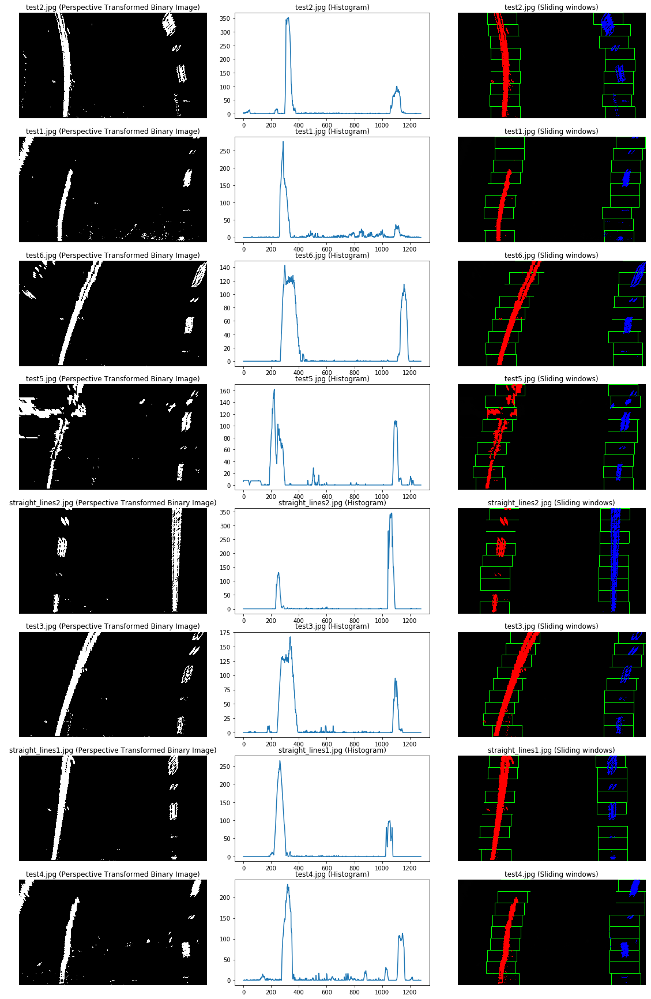

In [13]:
test_images = glob.glob('test_images/*.jpg')

num_images = len(test_images)
fig, ax = plt.subplots(num_images, 3, figsize=(16, 3 * num_images))
fig.tight_layout()
for i in range(num_images):
    fname = test_images[i]

#for fname in test_images:
    img = mpimg.imread(fname)
    
    # Draw the undistorted RGB image
    img_undistort = cv2.undistort(img, mtx, dist, None, mtx)
    Thresholded_binary, color_binary = Thresh_Binary_Image(img_undistort)
    img_thresholded_binary_warped, M_binary, M_inv = Warped_image(Thresholded_binary)
    histogram = hist(img_thresholded_binary_warped)
    out_img,ploty,left_fit, right_fit, left_fitx, right_fitx, left_fit_cr,right_fit_cr = fit_polynomial(img_thresholded_binary_warped)
    
    ax[i,0].imshow(img_thresholded_binary_warped,cmap='gray')
    ax[i,0].set_title(fname.split('/')[1] + ' (Perspective Transformed Binary Image)')
    ax[i,0].axis('off')
    ax[i,1].plot(histogram)
    ax[i,1].set_title(fname.split('/')[1] + ' (Histogram)')
    #plt.savefig('histogram.png')
    ax[i,2].imshow(out_img)
    ax[i,2].set_title(fname.split('/')[1] + ' (Sliding windows)')
    ax[i,2].axis('off')
    
    save_directory = "output_images/"
    #    #if not os.path.isdir(save_directory):
    #    #    os.mkdir("C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/")
    filename = fname.split('/')[1]
    
    
    slidewindows_filepath = save_directory + filename[:-4] + "_sliding_windows.jpg"   
    plt.imsave(slidewindows_filepath,out_img, cmap='gray')
        


In [14]:
#6. Determine the curvature of the lane and vehicle position with respect to center.

# determine the curvature of the lane in real world (unit: m)
def measure_curvature_real(left_fit_cr, right_fit_cr, ploty,ym_per_pix = 30/720):
    # Calculates the curvature of polynomial functions in meters.
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    ploty_cr = ploty * ym_per_pix
    y_eval = np.max(ploty_cr)
    
    # Implement the calculation of R_curve (radius of curvature)
    left_curverad = (1+(2*left_fit_cr[0]*y_eval + left_fit_cr[1])**2)**(1.5) /np.absolute(2*left_fit_cr[0]) 
    right_curverad = (1+(2*right_fit_cr[0]*y_eval + right_fit_cr[1])**2)**(1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_curverad, right_curverad

In [15]:
# I assume the camera is mounted at the center of the car, such that the lane center is the midpoint 
# at the bottom of the image between the two lines you've detected. 
# The offset of the lane center from the center of the image (converted from pixels to meters) 
# is your distance from the center of the lane.
def measure_offset_to_center(ploty, left_fit, right_fit, xm_per_pix = 3.7/880):
    y_max = np.max(ploty)
    left_x_coor = left_fit[0] * y_max**2 + left_fit[1] * y_max + left_fit[2]
    right_x_coor = right_fit[0] * y_max**2 + right_fit[1] * y_max + right_fit[2]
    lane_center_px = 1280 / 2
    center_offset_img_space = (left_x_coor + right_x_coor)/ 2 - lane_center_px
    center_offset_real_world = center_offset_img_space * xm_per_pix
    return center_offset_real_world

In [16]:
def drawing_lane_curvature_text(img_result, left_curverad, right_curverad, center_offset_real_world_m):
    txt_header1 = "Radius of Left Line Curvature: {:.1f} m.".format((left_curverad + right_curverad)/2)
    if center_offset_real_world_m > 0:
        txt_header2 = "Vehicle is {:.3f} m left of center.".format(np.abs(center_offset_real_world_m))
    else:
        txt_header2 = "Vehicle is {:.3f} m right of center.".format(np.abs(center_offset_real_world_m))
    
    cv2.putText(img_result, txt_header1, (40, 40), cv2.FONT_HERSHEY_COMPLEX, 1, (255,255,255), 1, cv2.LINE_AA)
    cv2.putText(img_result, txt_header2, (40, 80), cv2.FONT_HERSHEY_COMPLEX, 1, (255,255,255), 1, cv2.LINE_AA)

    return img_result

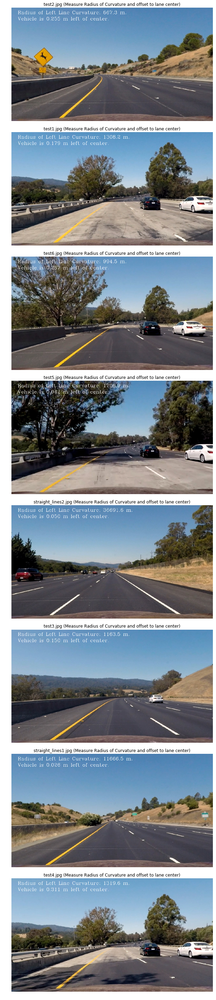

In [17]:
test_images = glob.glob('test_images/*.jpg')

num_images = len(test_images)
fig, ax = plt.subplots(num_images, 1, figsize=(16, 5 * num_images))
fig.tight_layout()
for i in range(num_images):
    fname = test_images[i]
    img = mpimg.imread(fname)
    img_undistort = cv2.undistort(img, mtx, dist, None, mtx)
    Thresholded_binary, color_binary = Thresh_Binary_Image(img_undistort)
    img_thresholded_binary_warped, M_binary, M_inv = Warped_image(Thresholded_binary)
    histogram = hist(img_thresholded_binary_warped)
    out_img,ploty,left_fit, right_fit, left_fitx, right_fitx, left_fit_cr,right_fit_cr = fit_polynomial(img_thresholded_binary_warped)
    left_curverad, right_curverad = measure_curvature_real(left_fit_cr, right_fit_cr, ploty)
    center_offset_real_world_m = measure_offset_to_center(ploty, left_fit, right_fit)
    result_image = np.copy(img_undistort)
    result_image = drawing_lane_curvature_text(result_image, left_curverad, right_curverad, center_offset_real_world_m)
    ax[i].imshow(result_image)
    ax[i].set_title(fname.split('/')[1] + ' (Measure Radius of Curvature and offset to lane center)')
    ax[i].axis('off')
    
    save_directory = "output_images/"
    #    #if not os.path.isdir(save_directory):
    #    #    os.mkdir("C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/")
    filename = fname.split('/')[1]
    
    result_filepath = save_directory + filename[:-4] + "_result_image.jpg"     
    plt.imsave(result_filepath, result_image) #, cmap='gray')
    
    #slidewindows_filepath = save_directory + filename[:-4] + "_Persepective Transformed binary.jpg"   
    #plt.imsave(slidewindows_filepath,out_img) #, cmap='gray')
    

In [18]:
# 7. Warp the detected lane boundaries back onto the original image

# define a function can warp the detected lane boundaries back onto the original image.
def drawing_lane_lines(undistort_image, binary_warped, M_inv, ploty, left_fitx, right_fitx):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warped = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warped, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warped, M_inv, (undistort_image.shape[1], undistort_image.shape[0])) 
    # Combine the result image with the original image
    result_image = cv2.addWeighted(undistort_image, 1, newwarp, 0.3, 0)
    return result_image

In [19]:
# 8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position

# define a pipeline to process single image
def Plot_Lane_Lines_Single_Image(img,src,dst,mtx, dist):
    img_undistort = cv2.undistort(img, mtx, dist, None, mtx)
    Thresholded_binary, color_binary = Thresh_Binary_Image(img_undistort)
    img_thresholded_binary_warped, M_binary, M_inv = Warped_image(Thresholded_binary)
    out_img,ploty,left_fit, right_fit, left_fitx, right_fitx, left_fit_cr,right_fit_cr = fit_polynomial(img_thresholded_binary_warped)
    left_curverad, right_curverad = measure_curvature_real(left_fit_cr, right_fit_cr, ploty)
    center_offset_real_world_m = measure_offset_to_center(ploty, left_fit, right_fit)
    result_image = drawing_lane_lines(img_undistort, img_thresholded_binary_warped, M_inv, ploty, left_fitx, right_fitx)
    result_image = drawing_lane_curvature_text(result_image, left_curverad, right_curverad, center_offset_real_world_m)
    return result_image

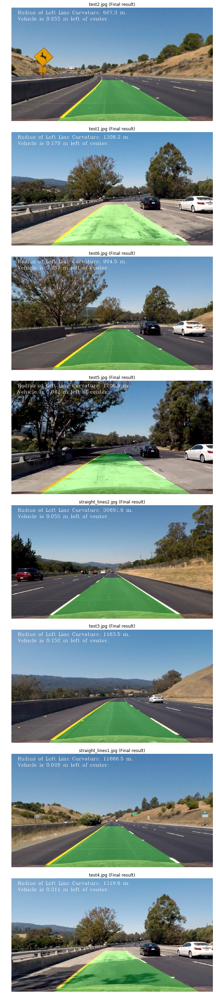

In [20]:
test_images = glob.glob('test_images/*.jpg')

num_images = len(test_images)
fig, ax = plt.subplots(num_images, 1, figsize=(16, 5 * num_images))
fig.tight_layout()
for i in range(num_images):
    fname = test_images[i]
    img = mpimg.imread(fname)
    result_image = Plot_Lane_Lines_Single_Image(img,src,dst,mtx, dist)     
    ax[i].imshow(result_image)
    ax[i].set_title(fname.split('/')[1] + ' (Final result)')
    ax[i].axis('off')
    
    save_directory = "output_images/"
    #    #if not os.path.isdir(save_directory):
    #    #    os.mkdir("C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/")
    filename = fname.split('/')[1]
    
    result_filepath = save_directory + filename[:-4] + "_Finalresult_image.jpg"     
    plt.imsave(result_filepath, result_image) #, cmap='gray')
    

In [21]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [22]:
class LaneLineDetector():
    def __init__(self):
        self.calib_images_dir = './camera_cal/calibration*.jpg'
        self.nx = 9
        self.ny = 6
        self.mtx = None
        self.dist = None
        self.s_thresh = (170, 255)
        self.sx_thresh = (20, 100)
        self.b_channel_lab_thresh = (155, 200)
        self.l_channel_luv_thresh = (225, 255)
        self.src = np.float32([[190,720],[578,460],[706,460],[1130,720]])
        self.dst = np.float32([[200,720],[200,0],[1080,0],[1080,720]])
        self.ym_per_pix = 30/720
        self.xm_per_pix = 3.7/880
        #self.xm_per_pix = 3.7/700
        # Choose the number of sliding windows
        self.nwindows = 9
        # Set the width of the windows +/- margin
        self.margin = 100
        # Set minimum number of pixels found to recenter window
        self.minpix = 50
        
    
    # define a function for camera calibration.
    def calibrate_camera(self, verbose=False, saveimg=False):

        # make sure the directory path exists
        #assert os.path.exists(self.calib_images_dir), '"{}" must exist and contain calibration images.'.format(self.calib_images_dir)

        # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
        objp = np.zeros((6 * 9, 3), np.float32)
        objp[:, :2] = np.mgrid[0:9, 0:6].T.reshape(-1, 2)

        # Arrays to store object points and image points from all the images.
        objpoints = []  # 3d points in real world space
        imgpoints = []  # 2d points in image plane.

        # Make a list of calibration images
        #images = glob.glob(path.join(self.calib_images_dir, 'calibration*.jpg'))
        images = glob.glob(self.calib_images_dir)

        # Step through the list and search for chessboard corners
        for fname in images:

            img = cv2.imread(fname)
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # Find the chessboard corners
            ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)

            if ret == True:
                objpoints.append(objp)
                imgpoints.append(corners)

                if verbose:
                    # Draw and display the corners
                    img = cv2.drawChessboardCorners(img, (9, 6), corners, ret)
                    filename = fname.split('/')[1]
                    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
                    #ax1.imshow(cv2.cvtColor(mpimg.imread(fname), cv2.COLOR_BGR2RGB))
                    ax1.imshow(cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB))
                    ax1.set_title(filename + '  Original Image', fontsize=18)
                    ax2.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                    ax2.set_title(filename + '  With Corners', fontsize=18)
                
                if saveimg:
                    save_directory = "C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/"
                    if not os.path.isdir(save_directory):
                        os.mkdir("C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/")
                    filename = fname.split('/')[1]
                    original_filepath = save_directory + filename[:-4] + "_original.jpg"
                    #cv2.imwrite(original_filepath,mpimg.imread(fname))
                    cv2.imwrite(original_filepath,cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB))
                    calibrated_filepath = save_directory + filename[:-4] + "_with_Corners.jpg"
                    cv2.imwrite(calibrated_filepath,cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
        self.mtx = mtx
        self.dist = dist
    



    def undistort(self, img, verbose=False, saveimg= False):
        img_undistorted = cv2.undistort(img, self.mtx, self.dist,None, self.mtx)

        if verbose:      
            f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
            ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            ax1.set_title(fname.split('/')[1] + '  Original Image', fontsize=18)
            ax2.imshow(cv2.cvtColor(img_undistorted, cv2.COLOR_BGR2RGB))
            ax2.set_title(fname.split('/')[1] + '  undistorted image', fontsize=18)
        
        if saveimg:            
            save_directory = "C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/"
            if not os.path.isdir(save_directory):
                 os.mkdir("C:/Users/Giridhar/Udacity projects/CarND-Advanced-Lane-Lines-master/output_images/")
            filename = fname.split('/')[1]
            undistort_filepath = save_directory + filename[:-4] + "_Undistorted.jpg"
            cv2.imwrite(undistort_filepath,img_undistorted)        
        
        return img_undistorted
    
    # define a function to use color transforms, sobel gradients to create a thresholded binary image 
       
    def Thresh_Binary_Image(self, img,verbose=False):
        img = np.copy(img)
    
        # Convert to HLS color space and separate the V channel
        hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        l_channel = hls[:,:,1]
        s_channel = hls[:,:,2]
    
        # Sobel x
        sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
        abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
        scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
        # Threshold x gradient
        sxbinary = np.zeros_like(scaled_sobel)
        sxbinary[(scaled_sobel >= self.sx_thresh[0]) & (scaled_sobel <= self.sx_thresh[1])] = 1
    
        # Threshold color channel
        s_binary = np.zeros_like(s_channel)
        s_binary[(s_channel >= self.s_thresh[0]) & (s_channel <= self.s_thresh[1])] = 1
    
        # Stack each channel
        color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
   
        #combined binary
        combined_binary = np.zeros_like(sxbinary)
        combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    
        if verbose:  
            f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 15))
            f.tight_layout()

            ax1.imshow(img)
            ax1.set_title('Original Image', fontsize=40)

            ax2.imshow(color_binary, cmap='gray')
            ax2.set_title('Color Binary image', fontsize=40)
    
            ax3.imshow(combined_binary, cmap='gray')
            ax3.set_title('Thresholded combined Binary image', fontsize=40)
            plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        
        return combined_binary, color_binary
        
    def Warped_image(self, img):
        # Compute and apply perpective transform
        img_size = (img.shape[1], img.shape[0])
        M = cv2.getPerspectiveTransform(self.src, self.dst)
        M_inv = cv2.getPerspectiveTransform(self.dst, self.src)
        warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)  
        
        return warped, M, M_inv  
        
    def hist(self,img):
        # Grab only the bottom half of the image
        # Lane lines are likely to be mostly vertical nearest to the car
        bottom_half = img[int(img.shape[0]/2):,:]
        # Sum across image pixels vertically - make sure to set `axis`
        # the highest areas of vertical lines should be larger values
        histogram = np.sum(bottom_half,axis=0)
        return histogram

    
    def find_lane_pixels(self,binary_warped):
        # Take a histogram of the bottom half of the image
        histogram = self.hist(binary_warped)
        # Create an output image to draw on and visualize the result
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]//2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint

        # Set height of windows - based on nwindows above and image shape
        window_height = np.int(binary_warped.shape[0]//self.nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated later for each window in nwindows
        leftx_current = leftx_base
        rightx_current = rightx_base

        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(self.nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
            # Find the four below boundaries of the window ###
            win_xleft_low = leftx_current - self.margin  
            win_xleft_high = leftx_current + self.margin  
            win_xright_low = rightx_current - self.margin  
            win_xright_high = rightx_current + self.margin 
        
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),
            (win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),
            (win_xright_high,win_y_high),(0,255,0), 2) 
        
            # Identify the nonzero pixels in x and y within the window
            good_left_boolean = (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high) & (nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
            good_left_inds = np.array( (nonzerox[good_left_boolean],nonzeroy[good_left_boolean]) ).T
            good_right_boolean = (nonzerox >= win_xright_low) & (nonzerox < win_xright_high) & (nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
            good_right_inds = np.array( (nonzerox[good_right_boolean],nonzeroy[good_right_boolean]) ).T
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
        
            # If found pixels > minpix pixels, recenter next window to let (`right` or `leftx_current`) on their mean position 
            if (good_left_inds.shape[0] > self.minpix):
                leftx_current = np.int(np.mean(good_left_inds[:,0]))
            if (good_right_inds.shape[0] > self.minpix):
                rightx_current = np.int(np.mean(good_right_inds[:,0]))

        # Concatenate the arrays of indices (previously was a list of lists of pixels)
        try:
            left_lane_inds = np.concatenate(left_lane_inds)
            right_lane_inds = np.concatenate(right_lane_inds)
        except ValueError:
            # Avoids an error if the above is not implemented fully
            print("ValueError: when using np.concatenate with left_lane_inds or right_lane_inds.")

        # Extract left and right line pixel positions
        leftx = left_lane_inds[:,0]
        lefty = left_lane_inds[:,1]
        rightx = right_lane_inds[:,0]
        righty = right_lane_inds[:,1]

        return leftx, lefty, rightx, righty, out_img
   

    # Define conversions in x and y from pixels space to meters
    # m_per_pix = 30/720 # meters per pixel in y dimension
    # xm_per_pix = 3.7/880 # meters per pixel in x dimension
    def fit_polynomial(self, binary_warped):
        # Find our lane pixels first
        leftx, lefty, rightx, righty, out_img = self.find_lane_pixels(binary_warped)

        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty,leftx,2)
        left_fit_cr = np.polyfit(lefty*self.ym_per_pix, leftx*self.xm_per_pix, 2)
        right_fit = np.polyfit(righty,rightx,2)
        right_fit_cr = np.polyfit(righty*self.ym_per_pix, rightx*self.xm_per_pix, 2)
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        try:
            left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
            right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        except TypeError:
            # Avoids an error if `left` and `right_fit` are still none or incorrect
            print('The function failed to fit a line!')
            left_fitx = 1*ploty**2 + 1*ploty
            right_fitx = 1*ploty**2 + 1*ploty

        #Visualization
        # Colors in the left and right lane regions
        out_img[lefty, leftx] = [255, 0, 0]
        out_img[righty, rightx] = [0, 0, 255]

        # Plots the left and right polynomials on the lane lines
        #plt.plot(left_fitx, ploty, color='yellow')
        #plt.plot(right_fitx, ploty, color='yellow')
        return out_img,ploty,left_fit, right_fit, left_fitx, right_fitx, left_fit_cr,right_fit_cr
   
    
    # determine the curvature of the lane in real world (unit: m)
    def measure_curvature_real(self, left_fit_cr, right_fit_cr, ploty):
        # Calculates the curvature of polynomial functions in meters.
        # Define y-value where we want radius of curvature
        # We'll choose the maximum y-value, corresponding to the bottom of the image
        # Note : Convert the ploty from the image pixel space to real world (units: from pixel to meter)
        ploty_cr = ploty * self.ym_per_pix
        y_eval = np.max(ploty_cr)
    
        # Implement the calculation of R_curve (radius of curvature)
        left_curverad = (1+(2*left_fit_cr[0]*y_eval + left_fit_cr[1])**2)**(1.5) /np.absolute(2*left_fit_cr[0]) 
        right_curverad = (1+(2*right_fit_cr[0]*y_eval + right_fit_cr[1])**2)**(1.5) / np.absolute(2*right_fit_cr[0])
    
        return left_curverad, right_curverad
    
        
    # I assume the camera is mounted at the center of the car, such that the lane center is the midpoint 
    # at the bottom of the image between the two lines you've detected. 
    # The offset of the lane center from the center of the image (converted from pixels to meters) 
    # is your distance from the center of the lane.
    def measure_offset_to_center(self, ploty, left_fit, right_fit):
        y_max = np.max(ploty)
        left_x_coor = left_fit[0] * y_max**2 + left_fit[1] * y_max + left_fit[2]
        right_x_coor = right_fit[0] * y_max**2 + right_fit[1] * y_max + right_fit[2]
        lane_center_px = 1280 / 2
        center_offset_img_space = (left_x_coor + right_x_coor)/ 2 - lane_center_px
        center_offset_real_world = center_offset_img_space * self.xm_per_pix
        return center_offset_real_world
    
    
    # define a function can warp the detected lane boundaries back onto the original image.
    
    def drawing_lane_lines(self, undistort_image, binary_warped, M_inv, ploty, left_fitx, right_fitx):   
        # Create an image to draw the lines on
        warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
        color_warped = np.dstack((warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warped, np.int_([pts]), (0,255, 0))

        # Warp the blank back to original image space using inverse perspective matrix (Minv)
        newwarp = cv2.warpPerspective(color_warped, M_inv, (undistort_image.shape[1], undistort_image.shape[0])) 
        # Combine the result image with the original image
        result_image = cv2.addWeighted(undistort_image, 1, newwarp, 0.3, 0)
        return result_image
   
    
    def drawing_lane_curvature_text(self,img_result, left_curverad, right_curverad, center_offset_real_world_m):
        txt_header1 = "Radius of Curvature: {:.1f} m.".format((left_curverad + right_curverad)/2)
        if center_offset_real_world_m > 0:
            txt_header2 = "Vehicle is {:.3f} m left of center.".format(np.abs(center_offset_real_world_m))
        else:
            txt_header2 = "Vehicle is {:.3f} m right of center.".format(np.abs(center_offset_real_world_m))
    
        cv2.putText(img_result, txt_header1, (40, 40), cv2.FONT_HERSHEY_COMPLEX, 1, (255,255,255), 1, cv2.LINE_AA)
        cv2.putText(img_result, txt_header2, (40, 80), cv2.FONT_HERSHEY_COMPLEX, 1, (255,255,255), 1, cv2.LINE_AA)
                
        return img_result
    
    def Plot_Lane_Lines_Single_Image(self, image):      
        img_undistort = self.undistort(image)
        Thresholded_binary, color_binary = self.Thresh_Binary_Image(img_undistort)
        img_thresholded_binary_warped, M_binary, M_inv = self.Warped_image(Thresholded_binary)
        out_img,ploty,left_fit, right_fit, left_fitx, right_fitx, left_fit_cr,right_fit_cr = self.fit_polynomial(img_thresholded_binary_warped)
        left_curverad, right_curverad = self.measure_curvature_real(left_fit_cr, right_fit_cr, ploty)
        center_offset_real_world_m = self.measure_offset_to_center(ploty, left_fit, right_fit)
        result_image = self.drawing_lane_lines(img_undistort, img_thresholded_binary_warped, M_inv, ploty, left_fitx, right_fitx)
        result_image = self.drawing_lane_curvature_text(result_image, left_curverad, right_curverad, center_offset_real_world_m)
        return result_image
        


In [ ]:
video_output = 'output_images/output_project_video.mp4'
Detector = LaneLineDetector()
Detector.calibrate_camera()
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("./project_video.mp4")
video_output_clip = clip1.fl_image(Detector.Plot_Lane_Lines_Single_Image) #NOTE: this function expects color images!!
%time video_output_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video output_images/output_project_video.mp4
[MoviePy] Writing video output_images/output_project_video.mp4


 86%|████████▌ | 1087/1261 [03:26<00:38,  4.54it/s]

In [24]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))